In [1]:
import os
os.environ["CUDA_VISIBLE_DEVICES"] = "0,1,2,3"
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3' 

import sys
sys.path.append('..')

import warnings
warnings.filterwarnings('ignore')

In [2]:
import numpy as np

import matplotlib.pyplot as plt
import seaborn as sns

import tensorflow as tf
from models.utils import decode_and_resize
from models.trainer import get_model
from models.network import ada_in
from models.data_loader import data_loader

from PIL import Image

In [3]:
tf.config.list_physical_devices('GPU')

[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU'),
 PhysicalDevice(name='/physical_device:GPU:1', device_type='GPU'),
 PhysicalDevice(name='/physical_device:GPU:2', device_type='GPU'),
 PhysicalDevice(name='/physical_device:GPU:3', device_type='GPU')]

In [4]:
# Load the data
train_ds, val_ds, test_ds = data_loader()

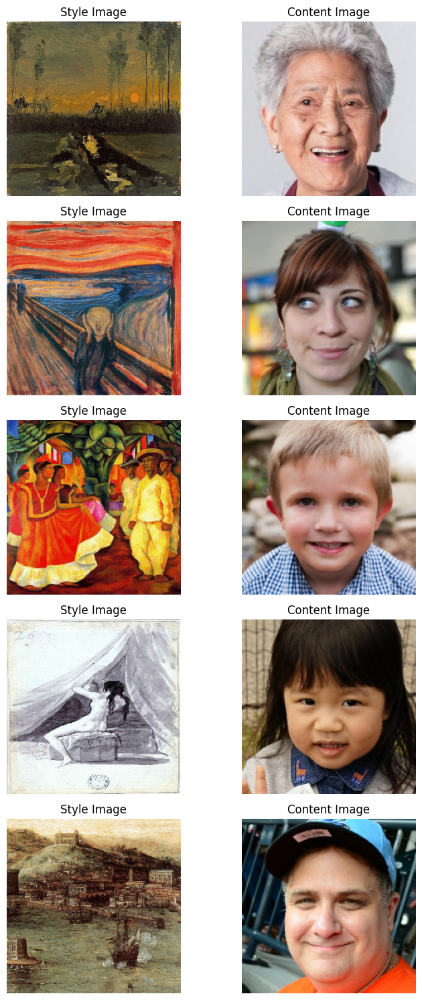

In [5]:
style, content = next(iter(train_ds))
fig, axes = plt.subplots(nrows=5, ncols=2, figsize=(8, 15))
[ax.axis("off") for ax in np.ravel(axes)]

for (axis, style_image, content_image) in zip(axes, style[0:5], content[0:5]):
    (ax_style, ax_content) = axis
    ax_style.imshow(style_image)
    ax_style.set_title("Style Image")

    ax_content.imshow(content_image)
    ax_content.set_title("Content Image")

plt.tight_layout()
plt.show()

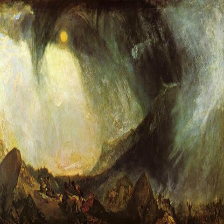

In [6]:
test_style = decode_and_resize("../data/sample/William_Turner_16.jpg")
test_content = decode_and_resize("../data/sample/hp2.jpg")

test_style = tf.expand_dims(test_style, axis=0)
test_content = tf.expand_dims(test_content, axis=0)

tf.keras.utils.array_to_img(test_style[0])

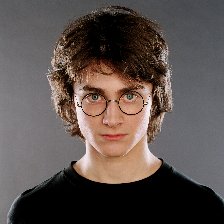

In [7]:
tf.keras.utils.array_to_img(test_content[0])

In [ ]:
from tensorflow.keras.callbacks import Callback
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.losses import MeanSquaredError

In [8]:
from models.trainer import train

In [9]:
model = get_model()
data = train_ds, val_ds, test_ds

Epoch 1/30


2023-08-08 07:48:53.344948: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:432] Loaded cuDNN version 8900
2023-08-08 07:49:11.283419: I tensorflow/compiler/xla/service/service.cc:168] XLA service 0x7fa82a0d4030 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2023-08-08 07:49:11.283459: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (0): Tesla T4, Compute Capability 7.5
2023-08-08 07:49:11.283466: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (1): Tesla T4, Compute Capability 7.5
2023-08-08 07:49:11.283471: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (2): Tesla T4, Compute Capability 7.5
2023-08-08 07:49:11.283477: I tensorflow/compiler/xla/service/service.cc:176]   StreamExecutor device (3): Tesla T4, Compute Capability 7.5
2023-08-08 07:49:11.289688: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:255] disabling MLIR crash reproducer, s

1000/1000 [==============================] - ETA: 0s - style_loss: 72.9313 - content_loss: 76.8707 - total_loss: 149.8021

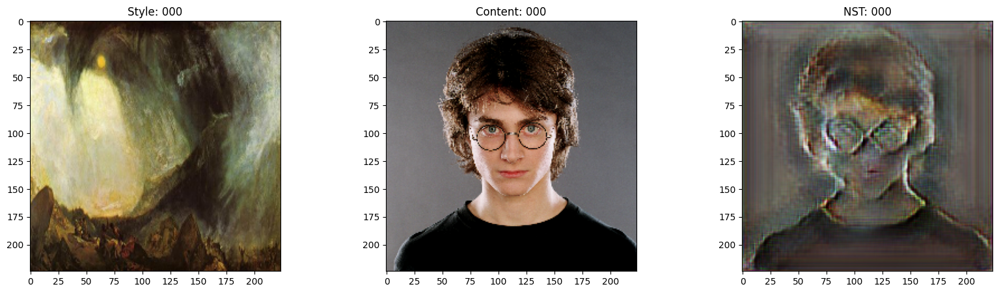

1000/1000 [==============================] - 1549s 2s/step - style_loss: 72.9313 - content_loss: 76.8707 - total_loss: 149.8021 - val_style_loss: 34.7651 - val_content_loss: 57.0827 - val_total_loss: 91.8477
Epoch 2/30
1000/1000 [==============================] - ETA: 0s - style_loss: 28.3861 - content_loss: 50.3500 - total_loss: 78.7360

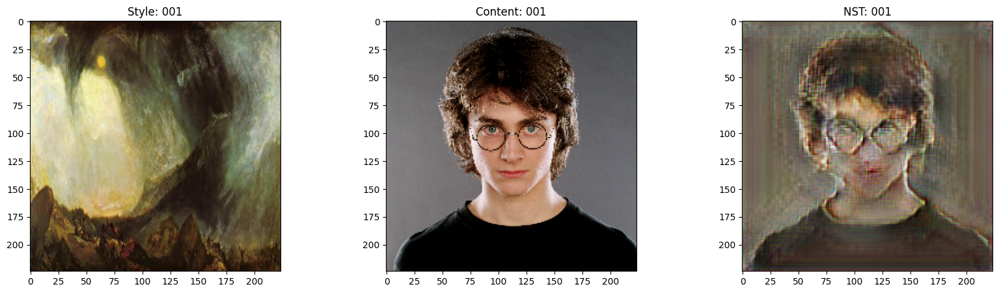

1000/1000 [==============================] - 1517s 2s/step - style_loss: 28.3861 - content_loss: 50.3500 - total_loss: 78.7360 - val_style_loss: 24.5895 - val_content_loss: 46.4331 - val_total_loss: 71.0226
Epoch 3/30
1000/1000 [==============================] - ETA: 0s - style_loss: 22.4635 - content_loss: 43.0764 - total_loss: 65.5399

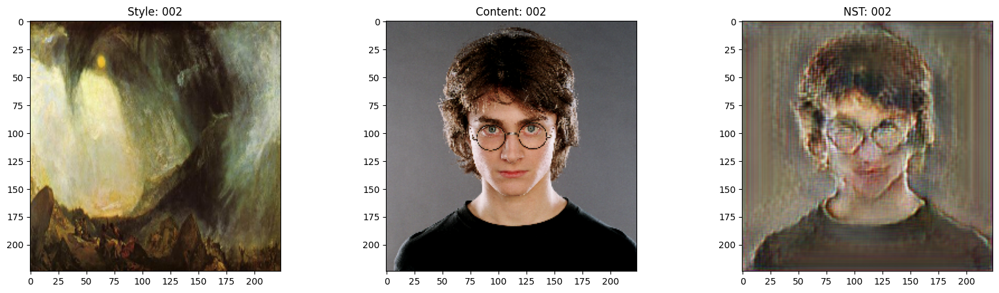

1000/1000 [==============================] - 1511s 2s/step - style_loss: 22.4635 - content_loss: 43.0764 - total_loss: 65.5399 - val_style_loss: 21.1845 - val_content_loss: 41.2207 - val_total_loss: 62.4052
Epoch 4/30
1000/1000 [==============================] - ETA: 0s - style_loss: 19.8700 - content_loss: 39.2192 - total_loss: 59.0893

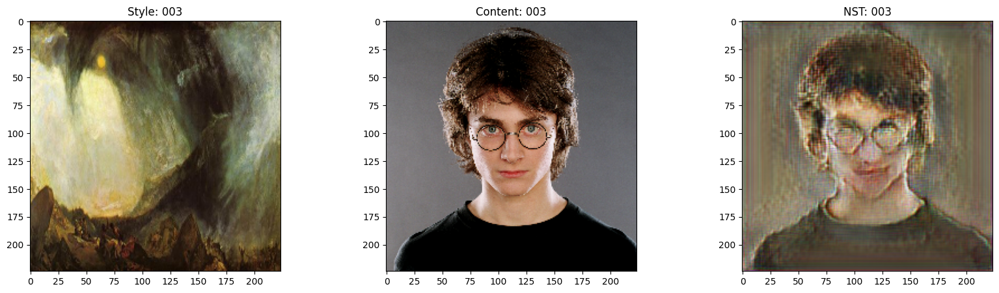

1000/1000 [==============================] - 1512s 2s/step - style_loss: 19.8700 - content_loss: 39.2192 - total_loss: 59.0893 - val_style_loss: 18.9389 - val_content_loss: 38.5126 - val_total_loss: 57.4515
Epoch 5/30
1000/1000 [==============================] - ETA: 0s - style_loss: 18.3190 - content_loss: 36.6842 - total_loss: 55.0031

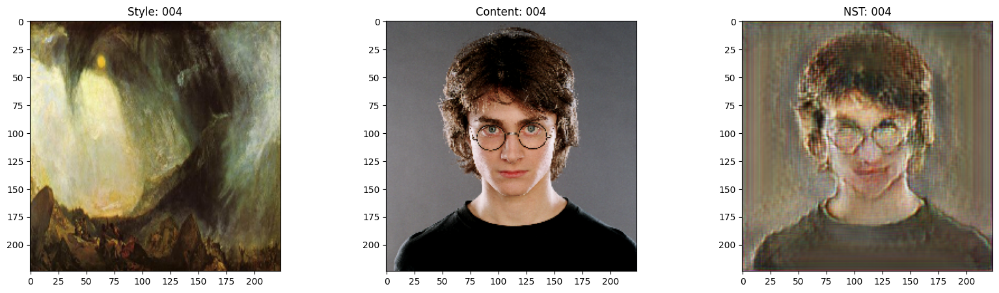

1000/1000 [==============================] - 1516s 2s/step - style_loss: 18.3190 - content_loss: 36.6842 - total_loss: 55.0031 - val_style_loss: 17.6779 - val_content_loss: 36.3219 - val_total_loss: 53.9998
Epoch 6/30
1000/1000 [==============================] - ETA: 0s - style_loss: 17.3161 - content_loss: 34.8087 - total_loss: 52.1248

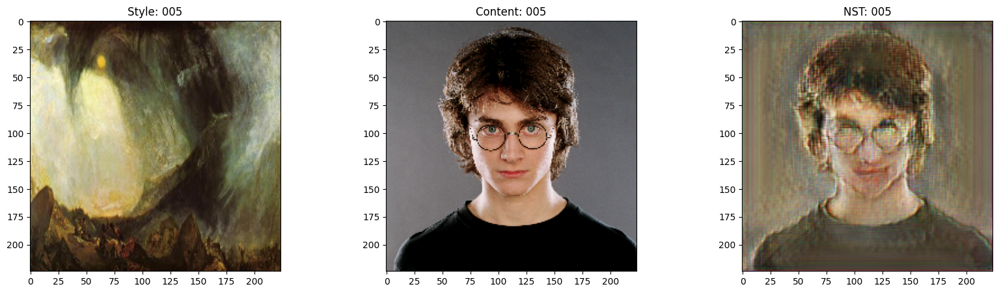

1000/1000 [==============================] - 1519s 2s/step - style_loss: 17.3161 - content_loss: 34.8087 - total_loss: 52.1248 - val_style_loss: 17.0275 - val_content_loss: 34.5098 - val_total_loss: 51.5374
Epoch 7/30
1000/1000 [==============================] - ETA: 0s - style_loss: 16.5490 - content_loss: 33.3721 - total_loss: 49.9212

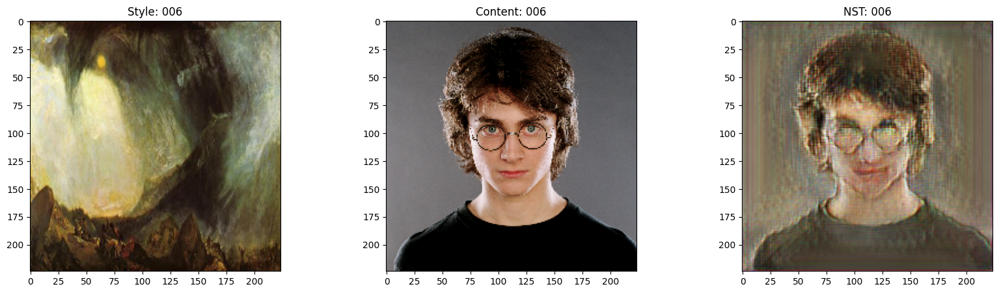

1000/1000 [==============================] - 1520s 2s/step - style_loss: 16.5490 - content_loss: 33.3721 - total_loss: 49.9212 - val_style_loss: 16.4580 - val_content_loss: 33.2770 - val_total_loss: 49.7350
Epoch 8/30
1000/1000 [==============================] - ETA: 0s - style_loss: 15.9818 - content_loss: 32.2077 - total_loss: 48.1895

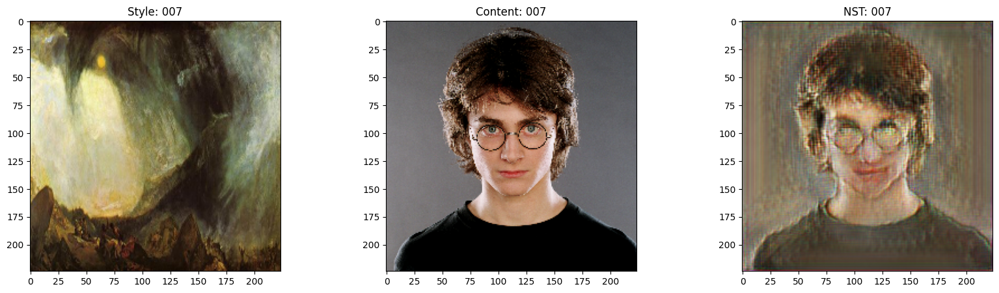

1000/1000 [==============================] - 1518s 2s/step - style_loss: 15.9818 - content_loss: 32.2077 - total_loss: 48.1895 - val_style_loss: 15.8803 - val_content_loss: 32.0440 - val_total_loss: 47.9242
Epoch 9/30
1000/1000 [==============================] - ETA: 0s - style_loss: 15.5206 - content_loss: 31.2248 - total_loss: 46.7453

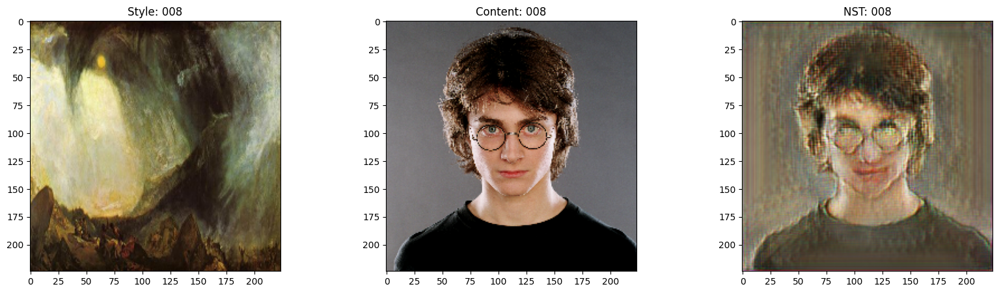

1000/1000 [==============================] - 1515s 2s/step - style_loss: 15.5206 - content_loss: 31.2248 - total_loss: 46.7453 - val_style_loss: 15.3909 - val_content_loss: 31.2606 - val_total_loss: 46.6515
Epoch 10/30
1000/1000 [==============================] - ETA: 0s - style_loss: 15.1471 - content_loss: 30.3860 - total_loss: 45.5330

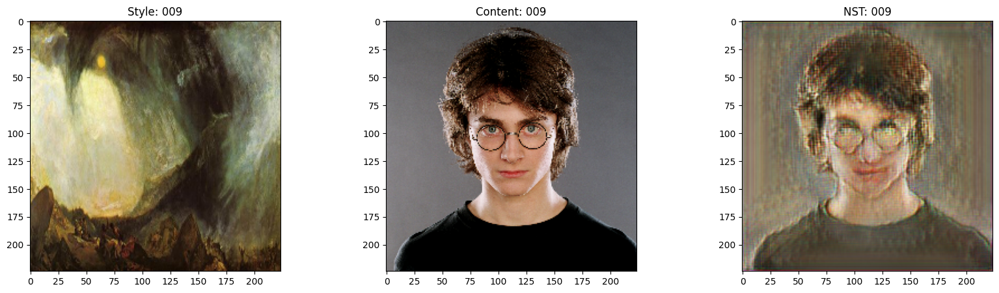

1000/1000 [==============================] - 1514s 2s/step - style_loss: 15.1471 - content_loss: 30.3860 - total_loss: 45.5330 - val_style_loss: 15.1770 - val_content_loss: 30.3423 - val_total_loss: 45.5193
Epoch 11/30
 380/1000 [==========>...................] - ETA: 12:28 - style_loss: 14.9065 - content_loss: 29.9170 - total_loss: 44.8234

IOPub message rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_msg_rate_limit`.

Current values:
ServerApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
ServerApp.rate_limit_window=3.0 (secs)



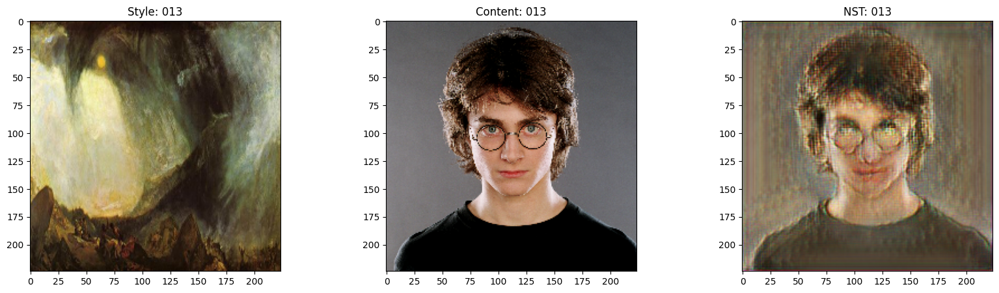

1000/1000 [==============================] - 1521s 2s/step - style_loss: 14.0592 - content_loss: 27.9297 - total_loss: 41.9889 - val_style_loss: 14.6214 - val_content_loss: 27.8505 - val_total_loss: 42.4719
Epoch 15/30
1000/1000 [==============================] - ETA: 0s - style_loss: 13.9125 - content_loss: 27.5054 - total_loss: 41.4179

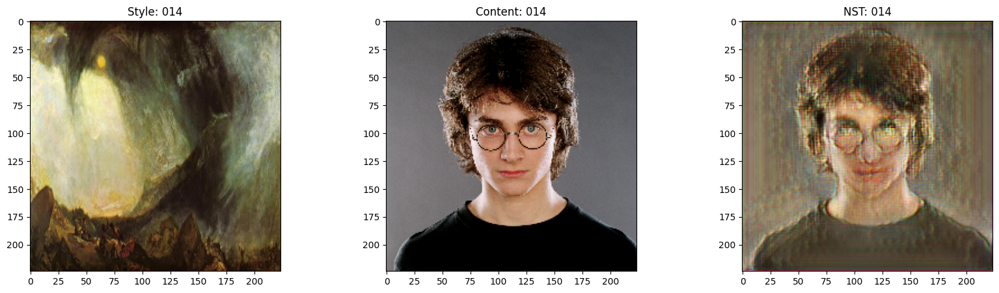

1000/1000 [==============================] - 1518s 2s/step - style_loss: 13.9125 - content_loss: 27.5054 - total_loss: 41.4179 - val_style_loss: 14.0643 - val_content_loss: 27.6695 - val_total_loss: 41.7338
Epoch 16/30
1000/1000 [==============================] - ETA: 0s - style_loss: 13.7295 - content_loss: 27.0509 - total_loss: 40.7804

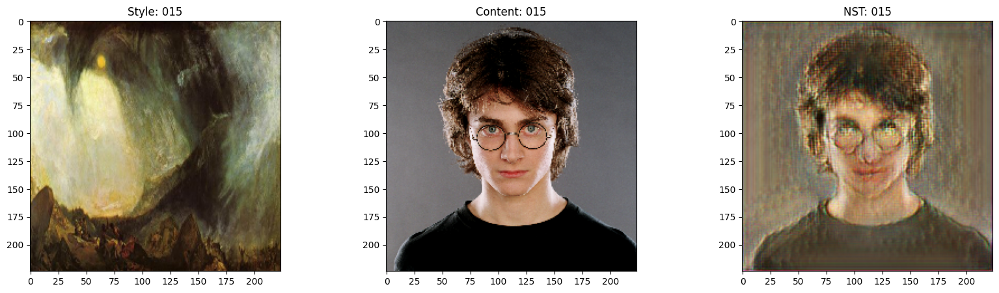

1000/1000 [==============================] - 1514s 2s/step - style_loss: 13.7295 - content_loss: 27.0509 - total_loss: 40.7804 - val_style_loss: 14.2655 - val_content_loss: 26.9339 - val_total_loss: 41.1994
Epoch 17/30
1000/1000 [==============================] - ETA: 0s - style_loss: 13.5737 - content_loss: 26.6856 - total_loss: 40.2592

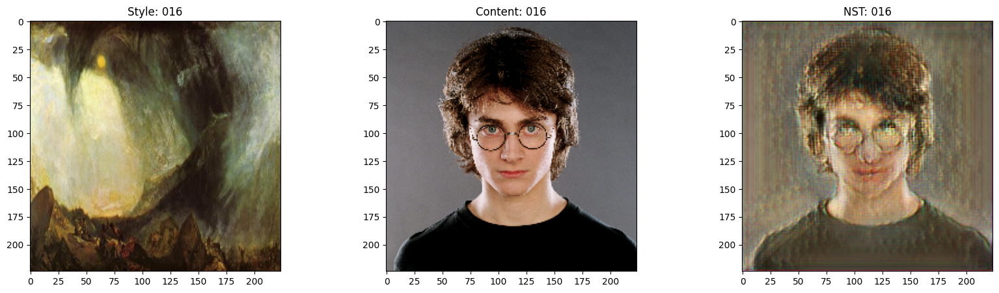

1000/1000 [==============================] - 1519s 2s/step - style_loss: 13.5737 - content_loss: 26.6856 - total_loss: 40.2592 - val_style_loss: 13.4208 - val_content_loss: 27.1329 - val_total_loss: 40.5537
Epoch 18/30
1000/1000 [==============================] - ETA: 0s - style_loss: 13.4129 - content_loss: 26.2795 - total_loss: 39.6924

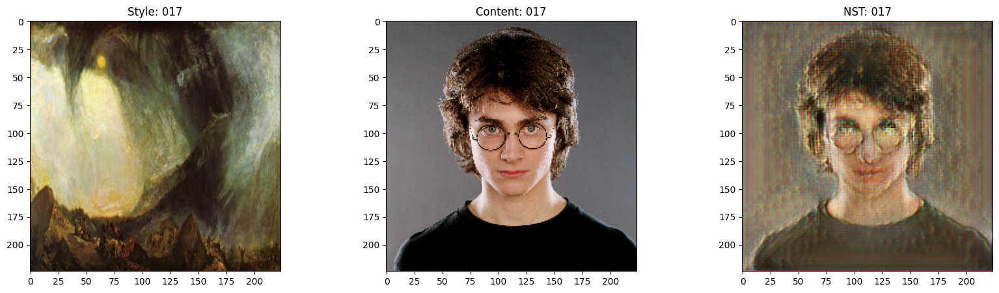

1000/1000 [==============================] - 1515s 2s/step - style_loss: 13.4129 - content_loss: 26.2795 - total_loss: 39.6924 - val_style_loss: 13.5188 - val_content_loss: 26.5642 - val_total_loss: 40.0830
Epoch 19/30
1000/1000 [==============================] - ETA: 0s - style_loss: 13.2892 - content_loss: 25.9773 - total_loss: 39.2665

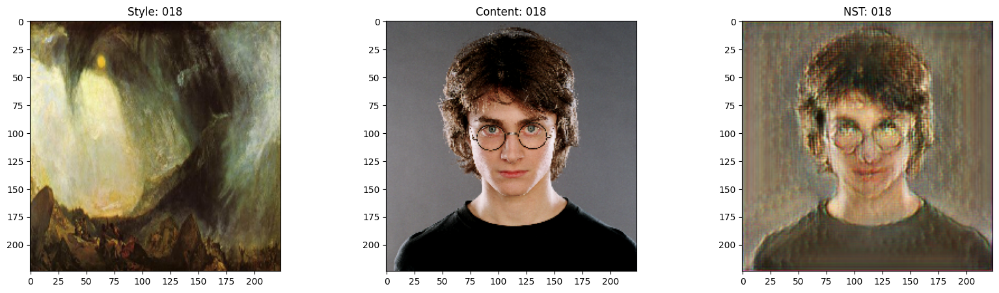

1000/1000 [==============================] - 1517s 2s/step - style_loss: 13.2892 - content_loss: 25.9773 - total_loss: 39.2665 - val_style_loss: 13.5195 - val_content_loss: 26.0501 - val_total_loss: 39.5697
Epoch 20/30
1000/1000 [==============================] - ETA: 0s - style_loss: 13.1795 - content_loss: 25.6859 - total_loss: 38.8654

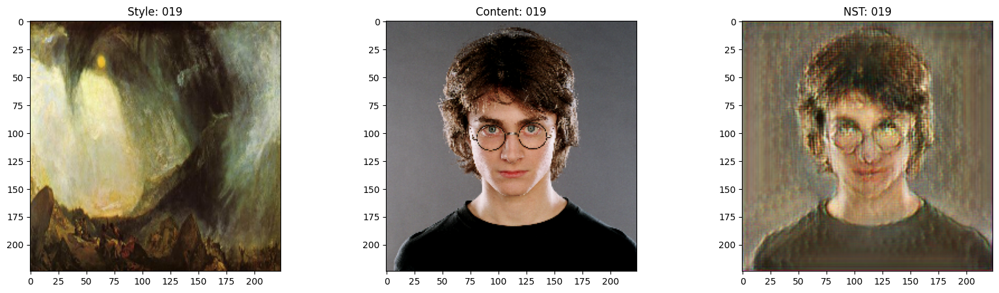

1000/1000 [==============================] - 1521s 2s/step - style_loss: 13.1795 - content_loss: 25.6859 - total_loss: 38.8654 - val_style_loss: 13.4286 - val_content_loss: 25.7337 - val_total_loss: 39.1623
Epoch 21/30
1000/1000 [==============================] - ETA: 0s - style_loss: 13.0731 - content_loss: 25.4088 - total_loss: 38.4819

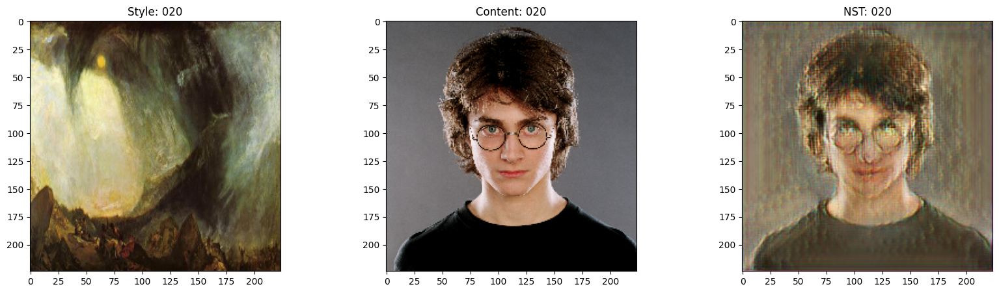

1000/1000 [==============================] - 1518s 2s/step - style_loss: 13.0731 - content_loss: 25.4088 - total_loss: 38.4819 - val_style_loss: 13.6107 - val_content_loss: 25.6608 - val_total_loss: 39.2715
Epoch 22/30
1000/1000 [==============================] - ETA: 0s - style_loss: 12.9753 - content_loss: 25.1409 - total_loss: 38.1162

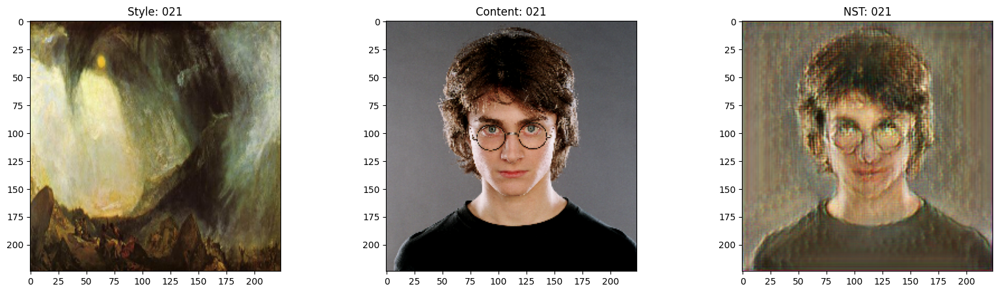

1000/1000 [==============================] - 1514s 2s/step - style_loss: 12.9753 - content_loss: 25.1409 - total_loss: 38.1162 - val_style_loss: 13.1167 - val_content_loss: 25.3479 - val_total_loss: 38.4645
Epoch 23/30
1000/1000 [==============================] - ETA: 0s - style_loss: 12.8529 - content_loss: 24.8776 - total_loss: 37.7305

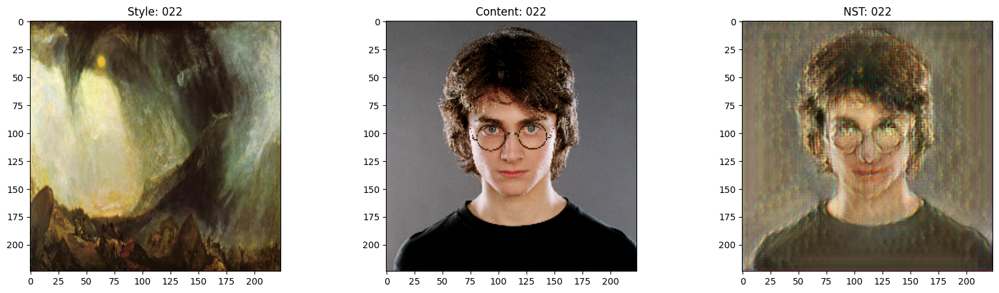

1000/1000 [==============================] - 1519s 2s/step - style_loss: 12.8529 - content_loss: 24.8776 - total_loss: 37.7305 - val_style_loss: 13.0086 - val_content_loss: 25.1415 - val_total_loss: 38.1501
Epoch 24/30
1000/1000 [==============================] - ETA: 0s - style_loss: 12.7819 - content_loss: 24.6458 - total_loss: 37.4276

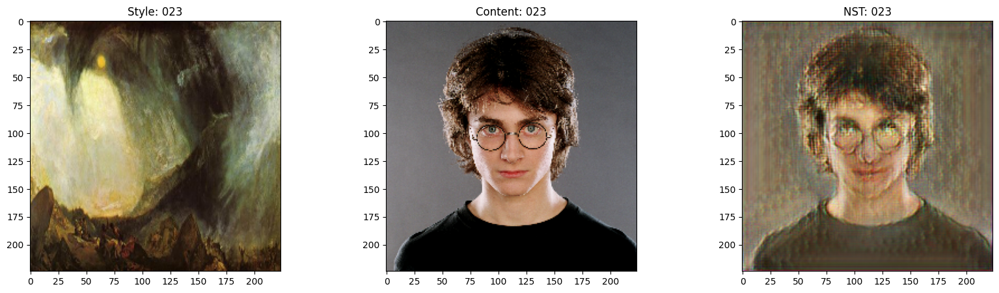

1000/1000 [==============================] - 1517s 2s/step - style_loss: 12.7819 - content_loss: 24.6458 - total_loss: 37.4276 - val_style_loss: 13.0004 - val_content_loss: 24.8915 - val_total_loss: 37.8918
Epoch 25/30
1000/1000 [==============================] - ETA: 0s - style_loss: 12.7073 - content_loss: 24.4730 - total_loss: 37.1804

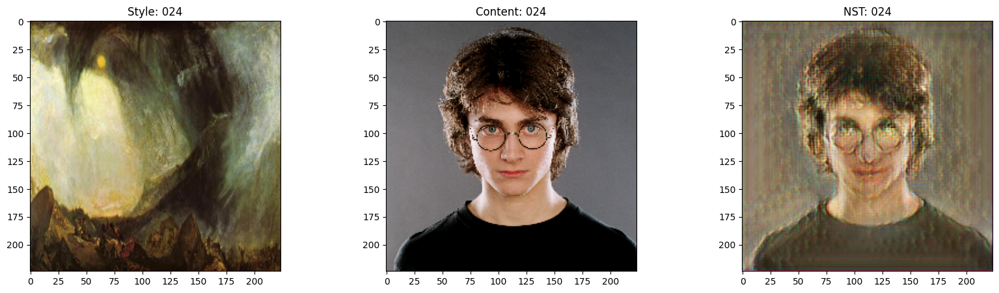

1000/1000 [==============================] - 1522s 2s/step - style_loss: 12.7073 - content_loss: 24.4730 - total_loss: 37.1804 - val_style_loss: 12.6982 - val_content_loss: 24.7675 - val_total_loss: 37.4656
Epoch 26/30
1000/1000 [==============================] - ETA: 0s - style_loss: 12.6136 - content_loss: 24.2329 - total_loss: 36.8465

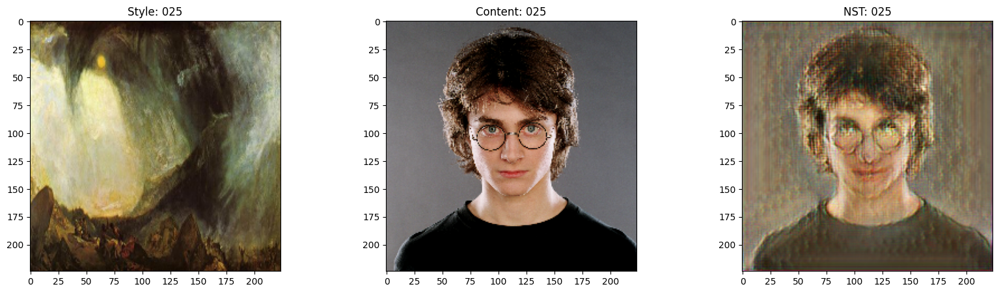

1000/1000 [==============================] - 1521s 2s/step - style_loss: 12.6136 - content_loss: 24.2329 - total_loss: 36.8465 - val_style_loss: 12.7145 - val_content_loss: 24.5769 - val_total_loss: 37.2913
Epoch 27/30
1000/1000 [==============================] - ETA: 0s - style_loss: 12.5649 - content_loss: 24.0772 - total_loss: 36.6421

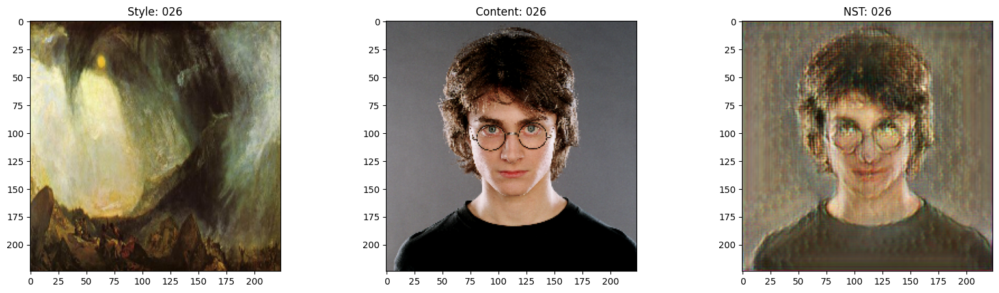

1000/1000 [==============================] - 1521s 2s/step - style_loss: 12.5649 - content_loss: 24.0772 - total_loss: 36.6421 - val_style_loss: 12.5063 - val_content_loss: 24.6697 - val_total_loss: 37.1760
Epoch 28/30
1000/1000 [==============================] - ETA: 0s - style_loss: 12.4652 - content_loss: 23.8635 - total_loss: 36.3287

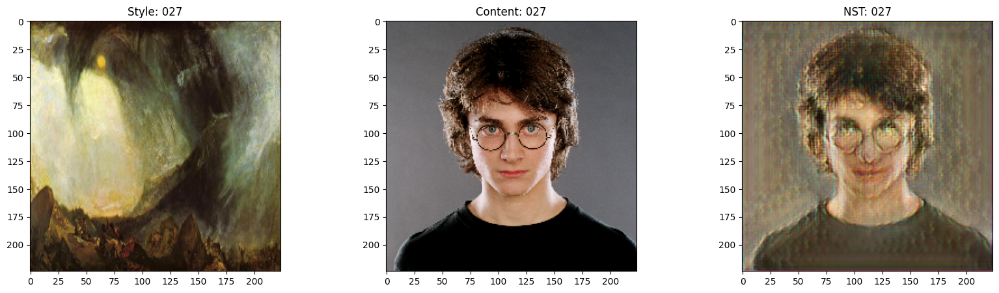

1000/1000 [==============================] - 1519s 2s/step - style_loss: 12.4652 - content_loss: 23.8635 - total_loss: 36.3287 - val_style_loss: 12.5267 - val_content_loss: 24.3095 - val_total_loss: 36.8363
Epoch 29/30
1000/1000 [==============================] - ETA: 0s - style_loss: 12.4200 - content_loss: 23.7267 - total_loss: 36.1466

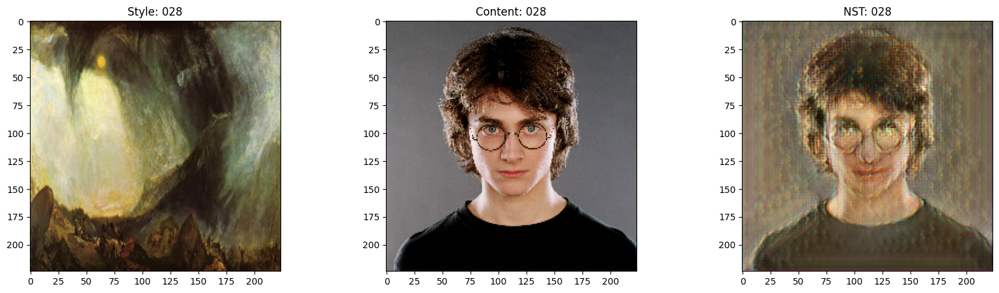

1000/1000 [==============================] - 1518s 2s/step - style_loss: 12.4200 - content_loss: 23.7267 - total_loss: 36.1466 - val_style_loss: 12.5112 - val_content_loss: 23.9933 - val_total_loss: 36.5045
Epoch 30/30
1000/1000 [==============================] - ETA: 0s - style_loss: 12.3304 - content_loss: 23.5281 - total_loss: 35.8585

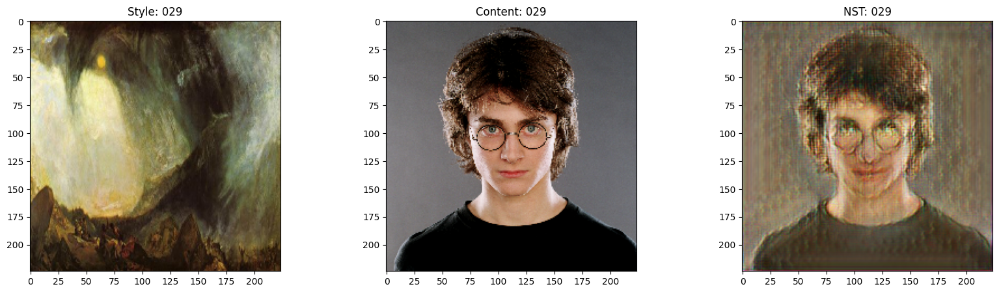

1000/1000 [==============================] - 1525s 2s/step - style_loss: 12.3304 - content_loss: 23.5281 - total_loss: 35.8585 - val_style_loss: 12.5774 - val_content_loss: 23.6780 - val_total_loss: 36.2554


In [21]:
history, model = train(model, data)

In [22]:
history.history.keys()

dict_keys(['style_loss', 'content_loss', 'total_loss', 'val_style_loss', 'val_content_loss', 'val_total_loss'])

In [30]:
model.save("models/art_style/art_style.keras")

In [31]:
model.save_weights("models/art_style/weights/art_style_weights")

In [28]:
model.to_json()

'{"class_name": "NeuralStyleTransfer", "config": {}, "keras_version": "2.13.1", "backend": "tensorflow"}'

In [29]:
model.get_config()

{}

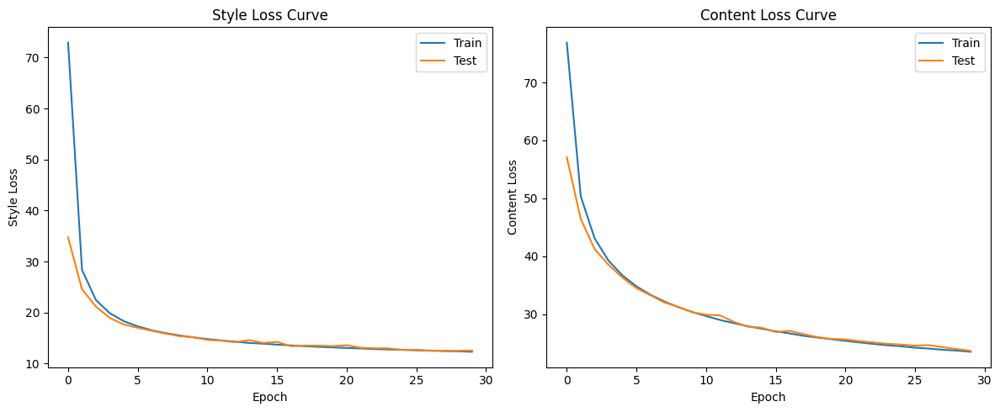

In [25]:
# Plot the loss and accuracy curves
fig, axes = plt.subplots(1, 2, figsize=(12, 5))

sns.lineplot(history.history['style_loss'], ax=axes[0], label="Train")
sns.lineplot(history.history['val_style_loss'], ax=axes[0], label="Test")

sns.lineplot(history.history['content_loss'], ax=axes[1], label="Train")
sns.lineplot(history.history['val_content_loss'], ax=axes[1], label="Test")

axes[0].set_title('Style Loss Curve')
axes[0].set_ylabel('Style Loss')
axes[0].set_xlabel('Epoch')
axes[0].legend()

axes[1].set_title('Content Loss Curve')
axes[1].set_ylabel('Content Loss')
axes[1].set_xlabel('Epoch')
axes[1].legend()

plt.tight_layout()
plt.show()

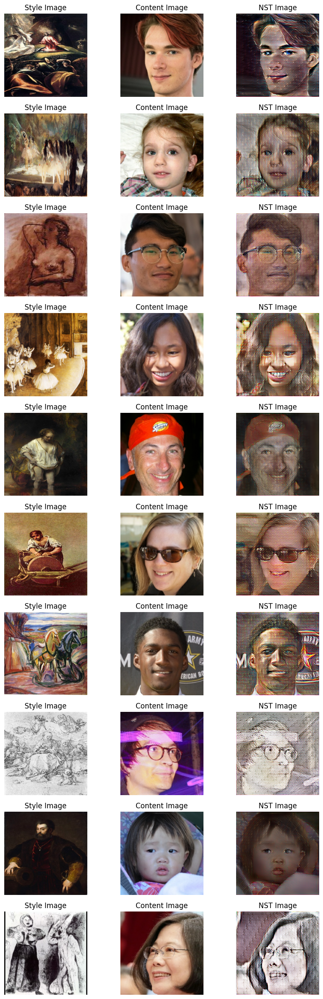

In [26]:
for style, content in test_ds.take(1):
    style_encoded = model.encoder(style)
    content_encoded = model.encoder(content)
    t = ada_in(style=style_encoded, content=content_encoded)
    reconstructed_image = model.decoder(t)
    fig, axes = plt.subplots(nrows=10, ncols=3, figsize=(10, 30))
    [ax.axis("off") for ax in np.ravel(axes)]

    for axis, style_image, content_image, reconstructed_image in zip(
        axes, style[0:10], content[0:10], reconstructed_image[0:10]
    ):
        (ax_style, ax_content, ax_reconstructed) = axis
        ax_style.imshow(style_image)
        ax_style.set_title("Style Image")
        ax_content.imshow(content_image)
        ax_content.set_title("Content Image")
        ax_reconstructed.imshow(reconstructed_image)
        ax_reconstructed.set_title("NST Image")